# Análisis Exploratorio de Datos

## Importación de librerias

In [1]:
#Importamos las librerias necesarias
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import datetime
from matplotlib import cm
from matplotlib.colors import ListedColormap
import warnings
warnings.filterwarnings("ignore")

## Configuración visual

In [2]:
#Configuración visual
plt.style.use('seaborn-v0_8')
sns.set(style="whitegrid")
plt.rcParams['figure.figsize'] = (12, 4)
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['axes.titlesize'] = 14
plt.rcParams['xtick.labelsize'] = 10
plt.rcParams['ytick.labelsize'] = 10

viridis = cm.get_cmap('viridis', 256)
magma = cm.get_cmap('magma', 256)
plasma = cm.get_cmap('plasma', 256)

## Carga de archivos

In [ ]:
# Cargamos el archivo limpio de Airbnb Barcelona
df = pd.read_csv(r'data\limpio_airbnb_Barcelona.csv')

In [11]:
# Cargamos el archivo de licencias turñisticas de Barcelona (fuente: Datos gobierno españa)
df2 = pd.read_csv(r'data\datos vivienda turistica bcn oficiales.csv')

In [4]:
#Leemos el archivo y comprobamos que se haya subido correctamente
df.head(2)

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,...,fecha_inicio_host,tiempo_como_anfitrion,distancia_centro_km,categoria_precio,reviews_norm,rating_norm,indice_popularidad,rendimiento_economico,rendimiento_economico_mensual,categoria_distancia_centro
0,18674,Huge flat for 8 people close to Sagrada Familia,71615,Mireia Maria,Eixample,la Sagrada Família,41.405560,2.17262,Entire home/apt,179.0,...,1900-01-01,NaN,2.069639,caro,0.014558,0.003918,0.011366,55.49,1664.7,media
1,23197,"Forum CCIB DeLuxe, Spacious, Large Balcony, relax",90417,Etain (Marnie),Sant Martí,el Besòs i el Maresme,41.412432,2.21975,Entire home/apt,251.0,...,2025-01-03,0.473648,5.079939,caro,0.026529,0.006067,0.020390,120.48,3614.4,lejos


In [12]:
#Leemos el archivo y comprobamos que se haya subido correctamente
df2.head(2)

,N_EXPEDIENT,CODI_DISTRICTE,NOM_DISTRICTE,CODI_BARRI,NOM_BARRI,TIPUS_CARRER,CARRER,TIPUS_NUM,NUM1,LLETRA1,...,LLETRA2,BLOC,PORTAL,ESCALA,PIS,PORTA,NUMERO_REGISTRE_GENERALITAT,NUMERO_PLACES,LONGITUD_X,LATITUD_Y
0,01-2009-0354,1,CIUTAT VELLA,1.0,el Raval,Carrer,SANT JOSEP ORIOL,1,19,NaN,...,NaN,NaN,NaN,NaN,01,1,HUTB-002222,3.0,"2,17017206787341","41,3784454355655"
1,01-2011-0123,1,CIUTAT VELLA,4.0,"Sant Pere, Santa Caterina i la Ribera",Carrer,AGULLERS,2,22,NaN,...,NaN,NaN,NaN,NaN,1,NaN,HUTB-003654,3.0,"2,18200417667745","41,3828840594187"


## Análisis

### 1.Tipos de Airbnb en la ciudad de Barcelona

<Figure size 1200x700 with 0 Axes>

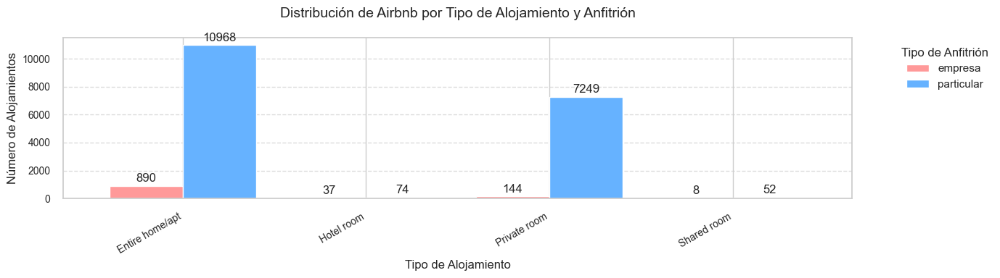

In [38]:
# Group the data by room type and host type
room_type_counts = df.groupby(['room_type', 'tipo_anfitrion']).size().unstack()

# Create figure and axis with larger size
plt.figure(figsize=(12, 7))

# Create the bar plot with a softer color palette
colors = ['#FF9999', '#66B2FF']
ax = room_type_counts.plot(kind='bar', width=0.8, color=colors)

# Customize the plot
plt.title('Distribución de Airbnb por Tipo de Alojamiento y Anfitrión', pad=20, fontsize=14)
plt.xlabel('Tipo de Alojamiento', fontsize=12)
plt.ylabel('Número de Alojamientos', fontsize=12)

# Add value labels on top of each bar with percentage
for i in ax.containers:
    ax.bar_label(i, label_type='edge', padding=2, fmt='%.0f')
    
# Rotate x-axis labels for better readability
plt.xticks(rotation=30, ha='right')

# Add grid for better readability
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Adjust layout to prevent label cutoff
plt.tight_layout()

# Add legend with better placement
plt.legend(title='Tipo de Anfitrión', bbox_to_anchor=(1.05, 1), loc='upper left')

# Make the plot interactive
plt.show()

### 2. Año de creación del alojamiento

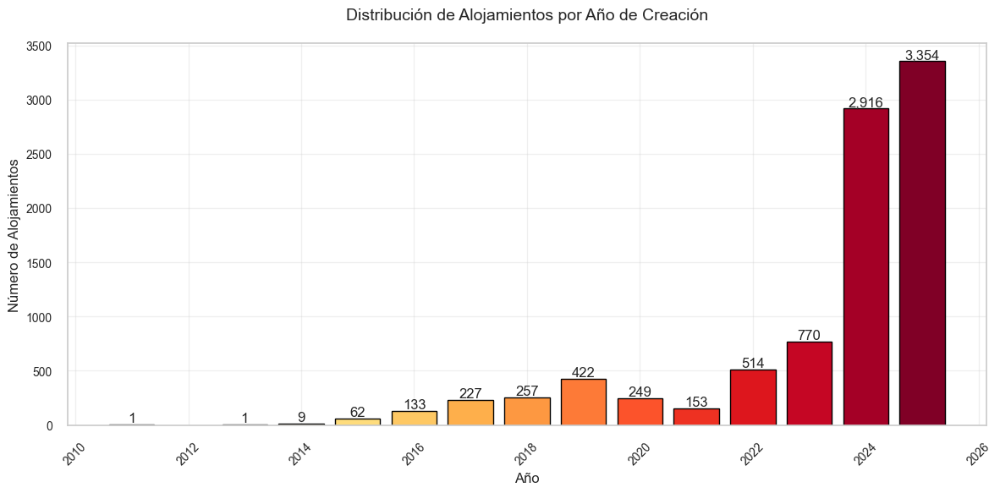

In [45]:
# Convert fecha_inicio_host to datetime and extract year
df['year'] = pd.to_datetime(df['fecha_inicio_host']).dt.year
# Add month to analyze trends
df['month'] = pd.to_datetime(df['fecha_inicio_host']).dt.month
df['year_month'] = pd.to_datetime(df['fecha_inicio_host']).dt.strftime('%Y-%m')

# Filter out years equal to 1900 (likely default values)
df_filtered = df[df['year'] != 1900]

# Count listings per year
yearly_counts = df_filtered['year'].value_counts().sort_index()

# Create a colormap that transitions from yellow to red
colors = plt.cm.YlOrRd(np.linspace(0, 1, len(yearly_counts)))

# Create the plot
plt.figure(figsize=(12, 6))

# Create bar plot with color gradient
bars = plt.bar(yearly_counts.index, yearly_counts.values, 
               color=colors, edgecolor='black')

# Add value labels on top of each bar
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height,
             f'{int(height):,}',
             ha='center', va='bottom')

# Customize the plot
plt.title('Distribución de Alojamientos por Año de Creación', pad=20)
plt.xlabel('Año')
plt.ylabel('Número de Alojamientos')

# Add grid
plt.grid(True, alpha=0.3)

# Rotate x-axis labels
plt.xticks(rotation=45)

# Adjust layout
plt.tight_layout()

plt.show()

### 3. Análisis del precio

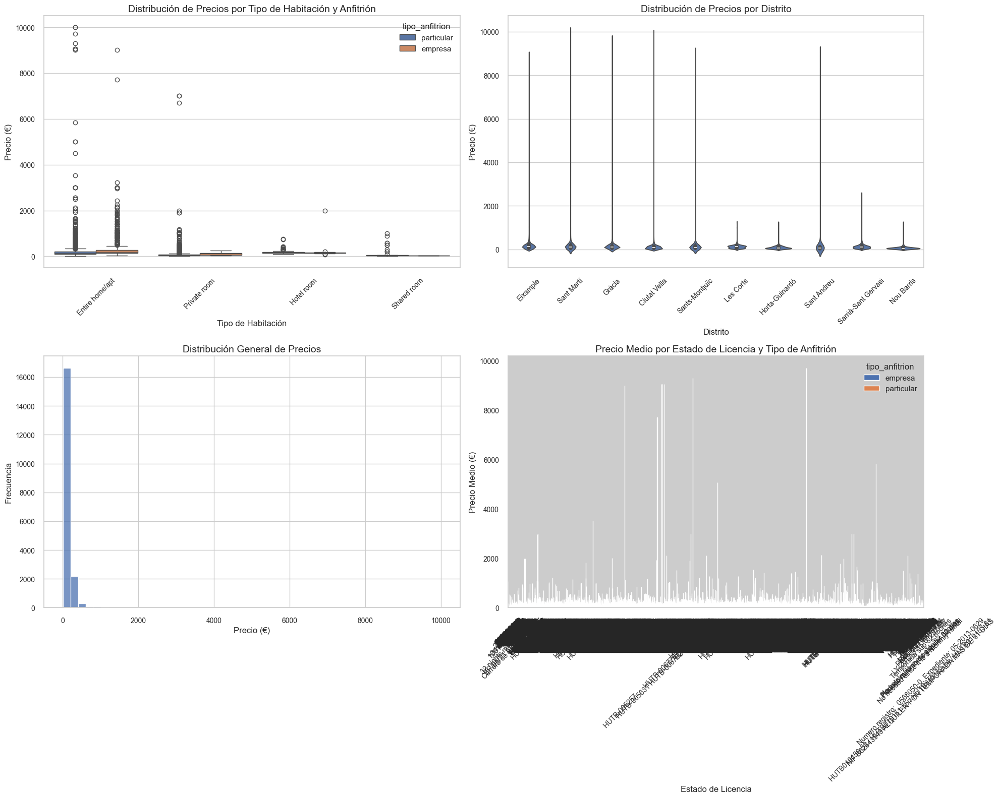

In [47]:
# Create a figure with multiple subplots
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 16))

# 1. Box plot of prices by room type and host type
sns.boxplot(data=df, x='room_type', y='price', hue='tipo_anfitrion', ax=ax1)
ax1.set_title('Distribución de Precios por Tipo de Habitación y Anfitrión')
ax1.set_xlabel('Tipo de Habitación')
ax1.set_ylabel('Precio (€)')
ax1.tick_params(axis='x', rotation=45)

# 2. Violin plot of prices by neighborhood group
sns.violinplot(data=df, x='neighbourhood_group', y='price', ax=ax2)
ax2.set_title('Distribución de Precios por Distrito')
ax2.set_xlabel('Distrito')
ax2.set_ylabel('Precio (€)')
ax2.tick_params(axis='x', rotation=45)

# 3. Histogram of prices
sns.histplot(data=df, x='price', bins=50, ax=ax3)
ax3.set_title('Distribución General de Precios')
ax3.set_xlabel('Precio (€)')
ax3.set_ylabel('Frecuencia')

# 4. Average price by license status and host type
avg_price = df.groupby(['license', 'tipo_anfitrion'])['price'].mean().unstack()
avg_price.plot(kind='bar', ax=ax4)
ax4.set_title('Precio Medio por Estado de Licencia y Tipo de Anfitrión')
ax4.set_xlabel('Estado de Licencia')
ax4.set_ylabel('Precio Medio (€)')
ax4.tick_params(axis='x', rotation=45)

# Adjust layout
plt.tight_layout()
plt.show()

### 2.Distribución de Airbnb según tipo de propietario

In [36]:
# Create a base map centered on Barcelona
map_bcn_owner = folium.Map(location=[41.3887, 2.1589], zoom_start=12)

# Create separate feature groups for each type of owner
empresas = folium.FeatureGroup(name='Empresas (Rojo)')
particulares = folium.FeatureGroup(name='Particulares (Azul)')

# Add points for each type with different colors
for idx, row in df.iterrows():
    if row['tipo_anfitrion'] == 'empresa':
        folium.CircleMarker(
            location=[row['latitude'], row['longitude']],
            radius=3,
            popup=f"Price: €{row['price']}<br>Type: {row['room_type']}<br>Neighborhood: {row['neighbourhood']}",
            color='red',
            fill=True,
            fill_opacity=0.7
        ).add_to(empresas)
    else:
        folium.CircleMarker(
            location=[row['latitude'], row['longitude']],
            radius=3,
            popup=f"Price: €{row['price']}<br>Type: {row['room_type']}<br>Neighborhood: {row['neighbourhood']}",
            color='blue',
            fill=True,
            fill_opacity=0.7
        ).add_to(particulares)

# Calculate statistics
total_companies = len(df[df['tipo_anfitrion'] == 'empresa'])
total_individuals = len(df[df['tipo_anfitrion'] == 'particular'])
total_listings = len(df)

# Add legend with total counts
legend_html = f'''
    <div style="position: fixed; 
    bottom: 50px; left: 50px; width: 300px; height: 120px; 
    border:2px solid grey; z-index:9999; font-size:14px;
    background-color:white;
    padding: 10px;
    ">
    <p><strong>Leyenda</strong></p>
    <p>
    <i class="fa fa-circle fa-1x" style="color:red"></i> Empresas ({total_companies}, {(total_companies/total_listings)*100:.1f}%)<br>
    <i class="fa fa-circle fa-1x" style="color:blue"></i> Particulares ({total_individuals}, {(total_individuals/total_listings)*100:.1f}%)<br>
    Total: {total_listings}
    </p>
    </div>
    '''
map_bcn_owner.get_root().html.add_child(folium.Element(legend_html))

# Add both feature groups to the map
empresas.add_to(map_bcn_owner)
particulares.add_to(map_bcn_owner)

# Add layer control
folium.LayerControl().add_to(map_bcn_owner)

# Display the map
map_bcn_owner

### 2. Distribución de airbnb sin datos de licencia

In [35]:
# First, ensure coordinates in both dataframes are in correct format
df2['LATITUD_Y'] = df2['LATITUD_Y'].astype(float)
df2['LONGITUD_X'] = df2['LONGITUD_X'].astype(float)

# Calculate statistics
unlicensed_companies = len(df[(df['license'] == 'sin datos') & (df['tipo_anfitrion'] == 'empresa')])
unlicensed_individuals = len(df[(df['license'] == 'sin datos') & (df['tipo_anfitrion'] == 'particular')])
unlicensed_count = unlicensed_companies + unlicensed_individuals
company_percentage = (unlicensed_companies / unlicensed_count) * 100
individual_percentage = (unlicensed_individuals / unlicensed_count) * 100

# Create a base map centered on Barcelona
map_bcn_no_license = folium.Map(location=[41.3887, 2.1589], zoom_start=12)

# Create separate feature groups for each type of owner
empresas_sin_licencia = folium.FeatureGroup(name='Empresas sin licencia (Rojo)')
particulares_sin_licencia = folium.FeatureGroup(name='Particulares sin licencia (Azul)')

# Create a set of tuples with coordinates from df2 (licensed properties)
licensed_coords = set(zip(df2['LATITUD_Y'], df2['LONGITUD_X']))

# Function to check if coordinates are close (within 50 meters)
def coords_match(lat1, lon1, licensed_coords, threshold=0.0005):
    for lat2, lon2 in licensed_coords:
        if abs(lat1 - lat2) < threshold and abs(lon1 - lon2) < threshold:
            return True
    return False

# Add points for properties without license and not in official database
for idx, row in df[df['license'] == 'sin datos'].iterrows():
    if not coords_match(row['latitude'], row['longitude'], licensed_coords):
        if row['tipo_anfitrion'] == 'empresa':
            folium.CircleMarker(
                location=[row['latitude'], row['longitude']],
                radius=3,
                popup=f"Price: €{row['price']}<br>Type: {row['room_type']}<br>Host: {row['tipo_anfitrion']}",
                color='red',
                fill=True,
                fill_opacity=0.7
            ).add_to(empresas_sin_licencia)
        else:
            folium.CircleMarker(
                location=[row['latitude'], row['longitude']],
                radius=3,
                popup=f"Price: €{row['price']}<br>Type: {row['room_type']}<br>Host: {row['tipo_anfitrion']}",
                color='blue',
                fill=True,
                fill_opacity=0.7
            ).add_to(particulares_sin_licencia)

# Create legend with statistics
legend_html = f'''
     <div style="position: fixed; 
     bottom: 50px; left: 50px; width: 300px; height: 120px; 
     border:2px solid grey; z-index:9999; font-size:14px;
     background-color:white;
     padding: 10px;
     ">
     <p><strong>Leyenda</strong></p>
     <p>
     <i class="fa fa-circle fa-1x" style="color:red"></i> Empresas sin licencia ({unlicensed_companies}, {company_percentage:.1f}%)<br>
     <i class="fa fa-circle fa-1x" style="color:blue"></i> Particulares sin licencia ({unlicensed_individuals}, {individual_percentage:.1f}%)<br>
     Total sin licencia: {unlicensed_count}
     </p>
     </div>
     '''

map_bcn_no_license.get_root().html.add_child(folium.Element(legend_html))

# Add feature groups to the map
empresas_sin_licencia.add_to(map_bcn_no_license)
particulares_sin_licencia.add_to(map_bcn_no_license)

# Add layer control
folium.LayerControl().add_to(map_bcn_no_license)

# Display the map
map_bcn_no_license